In [ ]:
!pip install osmnx

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.6/99.6 kB 1.8 MB/s eta 0:00:00


In [ ]:
import pandas as pd
import geopandas as gpd
import networkx as nx
import osmnx as ox
import matplotlib.pyplot as plt
import folium
import branca.colormap as cm
from folium.plugins import FloatImage
from google.colab import auth
import gspread
from google.auth import default

In [ ]:
# Connect with google drive
auth.authenticate_user()
creds, _ = default()
gc = gspread.authorize(creds)

In [ ]:
# Open the spreadsheet by its URL
spreadsheet_url = "link"
sh = gc.open_by_url(spreadsheet_url)
worksheet = sh.worksheet('min_stop')


In [ ]:
# Get all values from the worksheet as a list of lists
rows = worksheet.get_all_values()
   # Convert the list of lists to a pandas DataFrame
poi_df = pd.DataFrame.from_records(rows[1:], columns=rows[0])


In [ ]:
#Check data in dataframe
poi_df

,Stacja,min/stop_int,Latitude,Longitude
0,1 Maja 01,33.0,54.187624,16.182880
1,1 Maja 02,33.0,54.188113,16.182522
2,4 Marca 02 nż,36.0,54.181260,16.201780
3,Agrestowa 01,53.0,54.158136,16.213835
4,Agrestowa 02 nż,53.0,54.157508,16.213512
...,...,...,...,...
325,Żwirki i Wigury 02 nż,38.0,54.189557,16.162202
326,Żytnia 01,46.0,54.164963,16.184877
327,Żytnia 02,46.0,54.165477,16.184414
328,Żyzna 01 nż,53.0,54.239745,16.176800


In [ ]:
# Convert data types
poi_df['min/stop_int'] = poi_df['min/stop_int'].astype(float)
poi_df['Longitude'] = poi_df['Longitude'].astype(float)
poi_df['Latitude'] = poi_df['Latitude'].astype(float)

In [ ]:
# Create a walkable street network graph of Koszalin, Poland, within a 7km radius, and extracts the node GeoDataFrames.
G = ox.graph_from_address("Koszalin, Poland",
  dist=7000,
  network_type="walk",
  simplify=True)
gdf_nodes = ox.graph_to_gdfs(G, edges=False)

In [ ]:
# Check street neetwork graph
gdf_nodes

,y,x,street_count,highway,railway,ref,geometry
osmid,,,,,,,
243892960,54.260588,16.266277,3,NaN,NaN,NaN,POINT (16.26628 54.26059)
243892963,54.259180,16.267301,4,NaN,NaN,NaN,POINT (16.2673 54.25918)
243892967,54.258479,16.270315,3,NaN,NaN,NaN,POINT (16.27032 54.25848)
243892973,54.253914,16.276168,4,crossing,NaN,NaN,POINT (16.27617 54.25391)
243892978,54.247475,16.282688,4,crossing,NaN,NaN,POINT (16.28269 54.24748)
...,...,...,...,...,...,...,...
12549163477,54.173707,16.119866,1,NaN,NaN,NaN,POINT (16.11987 54.17371)
12549163478,54.173823,16.119037,3,NaN,NaN,NaN,POINT (16.11904 54.17382)
12549163479,54.174081,16.118820,1,NaN,NaN,NaN,POINT (16.11882 54.17408)


In [ ]:
# Loop through each row in poi_df
for index, row in poi_df.iterrows():
    # Get the latitude and longitude of the POI
    poi_lat = row['Latitude']
    poi_lon = row['Longitude']

    # Find the nearest node in the graph G using osmnx
    nearest_node = ox.distance.nearest_nodes(G, X=poi_lon, Y=poi_lat)

    # Store the nearest node ID in the poi_df DataFrame
    poi_df.at[index, 'nearest_node'] = nearest_node

# Display the updated poi_df with the nearest node IDs
print(poi_df)

                    Stacja  min/stop_int   Latitude  Longitude  nearest_node
0                1 Maja 01          33.0  54.187624  16.182880  2.705434e+09
1                1 Maja 02          33.0  54.188113  16.182522  9.524565e+09
2            4 Marca 02 nż          36.0  54.181260  16.201780  1.098325e+10
3             Agrestowa 01          53.0  54.158136  16.213835  1.418511e+09
4          Agrestowa 02 nż          53.0  54.157508  16.213512  1.366662e+09
..                     ...           ...        ...        ...           ...
325  Żwirki i Wigury 02 nż          38.0  54.189557  16.162202  7.412217e+09
326              Żytnia 01          46.0  54.164963  16.184877  5.692473e+09
327              Żytnia 02          46.0  54.165477  16.184414  4.776663e+09
328            Żyzna 01 nż          53.0  54.239745  16.176800  2.824591e+09
329            Żyzna 02 nż          53.0  54.239745  16.177003  2.824591e+09

[330 rows x 5 columns]


In [ ]:
# Add a new column to store the distance from the nearest node to the POI
poi_df['distance_to_node'] = None

# Loop through each row in poi_df
for index, row in poi_df.iterrows():
    # Get the latitude and longitude of the POI
    poi_lat = row['Latitude']
    poi_lon = row['Longitude']

    # Find the nearest node in the graph G using osmnx
    nearest_node = ox.distance.nearest_nodes(G, X=poi_lon, Y=poi_lat)

    # Get the latitude and longitude of the nearest node
    nearest_node_lat = G.nodes[nearest_node]['y']
    nearest_node_lon = G.nodes[nearest_node]['x']

    # Calculate the great-circle distance between the POI and the nearest node
    distance = ox.distance.great_circle(poi_lat, poi_lon, nearest_node_lat, nearest_node_lon)

    # Store the nearest node ID and distance in the poi_df DataFrame
    poi_df.at[index, 'nearest_node'] = nearest_node
    poi_df.at[index, 'distance_to_node'] = distance

# Display the updated poi_df with the nearest node IDs and distances
print(poi_df)

                    Stacja  min/stop_int   Latitude  Longitude  nearest_node  \
0                1 Maja 01          33.0  54.187624  16.182880  2.705434e+09   
1                1 Maja 02          33.0  54.188113  16.182522  9.524565e+09   
2            4 Marca 02 nż          36.0  54.181260  16.201780  1.098325e+10   
3             Agrestowa 01          53.0  54.158136  16.213835  1.418511e+09   
4          Agrestowa 02 nż          53.0  54.157508  16.213512  1.366662e+09   
..                     ...           ...        ...        ...           ...   
325  Żwirki i Wigury 02 nż          38.0  54.189557  16.162202  7.412217e+09   
326              Żytnia 01          46.0  54.164963  16.184877  5.692473e+09   
327              Żytnia 02          46.0  54.165477  16.184414  4.776663e+09   
328            Żyzna 01 nż          53.0  54.239745  16.176800  2.824591e+09   
329            Żyzna 02 nż          53.0  54.239745  16.177003  2.824591e+09   

    distance_to_node  
0           11.4

In [ ]:
# Create a new DataFrame to store the results
node_to_poi_distances = pd.DataFrame(columns=['node_id', 'nearest_poi_index', 'distance_to_poi'])

# Loop through each node in the graph
all_data = []  # Create an empty list to store the data
for node_id, node_data in G.nodes(data=True):
    # Get the latitude and longitude of the node
    node_lat = node_data['y']
    node_lon = node_data['x']

    # Calculate the distance from this node to all POIs
    distances = []
    for poi_index, poi_row in poi_df.iterrows():
        poi_lat = poi_row['Latitude']
        poi_lon = poi_row['Longitude']
        distance = ox.distance.great_circle(node_lat, node_lon, poi_lat, poi_lon)
        distances.append((poi_index, distance))

    # Find the nearest POI (the one with the minimum distance)
    nearest_poi_index, min_distance = min(distances, key=lambda x: x[1])

    # Append the data as a dictionary to the list
    all_data.append({
        'node_id': node_id,
        'nearest_poi_index': nearest_poi_index,
        'distance_to_poi': min_distance
    })

# Create the DataFrame outside the loop using pd.concat
node_to_poi_distances = pd.DataFrame(all_data)

# Display the resulting table
print(node_to_poi_distances)

           node_id  nearest_poi_index  distance_to_poi
0        243892960                144      5760.479898
1        243892963                144      5862.498306
2        243892967                144      6071.573672
3        243892973                270      6563.363535
4        243892978                136      6521.633284
...            ...                ...              ...
16114  12549163477                243      1240.721854
16115  12549163478                243      1287.150120
16116  12549163479                243      1291.495223
16117  12640681357                126       467.329528
16118  12640681358                 14       110.209329

[16119 rows x 3 columns]


In [ ]:
# Add a new column to store the walking distance
node_to_poi_distances['walking_distance'] = None

# Loop through each row in node_to_poi_distances
for index, row in node_to_poi_distances.iterrows():
    # Get the node ID and the nearest POI index
    node_id = row['node_id']
    nearest_poi_index = row['nearest_poi_index']

    # Get the nearest node ID for the POI from poi_df
    nearest_poi_node_id = poi_df.at[nearest_poi_index, 'nearest_node']

    try:
        # Calculate the shortest walking distance between the node and the nearest POI node
        walking_distance = nx.shortest_path_length(G, source=node_id, target=nearest_poi_node_id, weight='length')

        # Store the walking distance in the DataFrame
        node_to_poi_distances.at[index, 'walking_distance'] = walking_distance
    except nx.NetworkXNoPath:
        # Handle cases where no path exists between the nodes
        node_to_poi_distances.at[index, 'walking_distance'] = None
        print(f"No path found between node {node_id} and POI node {nearest_poi_node_id}.")

# Display the updated DataFrame with walking distances
print(node_to_poi_distances)

           node_id  nearest_poi_index  distance_to_poi walking_distance
0        243892960                144      5760.479898     11031.825684
1        243892963                144      5862.498306     10860.375854
2        243892967                144      6071.573672     11066.935699
3        243892973                270      6563.363535     10985.506612
4        243892978                136      6521.633284      7516.200123
...            ...                ...              ...              ...
16114  12549163477                243      1240.721854      1587.023486
16115  12549163478                243      1287.150120      1512.871519
16116  12549163479                243      1291.495223      1544.917839
16117  12640681357                126       467.329528       7404.39533
16118  12640681358                 14       110.209329       306.614876

[16119 rows x 4 columns]


In [ ]:
# Define walking speed in meters per second (m/s)
walking_speed = 1.4  # 1.4 m/s ≈ 5 km/h

# Add a new column to store the walking time
node_to_poi_distances['walking_time'] = None

# Loop through each row in node_to_poi_distances
for index, row in node_to_poi_distances.iterrows():
    # Get the node ID and the nearest POI index
    node_id = row['node_id']
    nearest_poi_index = row['nearest_poi_index']

    # Get the nearest node ID for the POI from poi_df
    nearest_poi_node_id = poi_df.at[nearest_poi_index, 'nearest_node']

    try:
        # Calculate the shortest walking distance between the node and the nearest POI node
        walking_distance = nx.shortest_path_length(G, source=node_id, target=nearest_poi_node_id, weight='length')

        # Calculate the walking time
        walking_time = walking_distance / walking_speed  # in seconds

        # Store the walking time in the DataFrame
        node_to_poi_distances.at[index, 'walking_time'] = walking_time
    except nx.NetworkXNoPath:
        # Handle cases where no path exists between the nodes
        node_to_poi_distances.at[index, 'walking_time'] = None
        print(f"No path found between node {node_id} and POI node {nearest_poi_node_id}.")

# Display the updated DataFrame with walking times
print(node_to_poi_distances)

           node_id  nearest_poi_index  distance_to_poi walking_distance  \
0        243892960                144      5760.479898     11031.825684   
1        243892963                144      5862.498306     10860.375854   
2        243892967                144      6071.573672     11066.935699   
3        243892973                270      6563.363535     10985.506612   
4        243892978                136      6521.633284      7516.200123   
...            ...                ...              ...              ...   
16114  12549163477                243      1240.721854      1587.023486   
16115  12549163478                243      1287.150120      1512.871519   
16116  12549163479                243      1291.495223      1544.917839   
16117  12640681357                126       467.329528       7404.39533   
16118  12640681358                 14       110.209329       306.614876   

      walking_time  
0      7879.875488  
1      7757.411324  
2      7904.954071  
3      7846.790

In [ ]:
# Convert walking time from seconds to minutes
node_to_poi_distances['walking_time_minutes'] = node_to_poi_distances['walking_time'] / 60

# Display the updated DataFrame
print(node_to_poi_distances)

           node_id  nearest_poi_index  distance_to_poi walking_distance  \
0        243892960                144      5760.479898     11031.825684   
1        243892963                144      5862.498306     10860.375854   
2        243892967                144      6071.573672     11066.935699   
3        243892973                270      6563.363535     10985.506612   
4        243892978                136      6521.633284      7516.200123   
...            ...                ...              ...              ...   
16114  12549163477                243      1240.721854      1587.023486   
16115  12549163478                243      1287.150120      1512.871519   
16116  12549163479                243      1291.495223      1544.917839   
16117  12640681357                126       467.329528       7404.39533   
16118  12640681358                 14       110.209329       306.614876   

      walking_time walking_time_minutes  
0      7879.875488           131.331258  
1      7757.411

In [ ]:
# Merge node_to_poi_distances with poi_df on the nearest_poi_index
merged_df = node_to_poi_distances.merge(
    poi_df[['min/stop_int']],
    left_on='nearest_poi_index',
    right_index=True,
    how='left'
)

# Calculate the sum of walking_time_minutes and min/stop_int
merged_df['total_time'] = merged_df['walking_time_minutes'] + merged_df['min/stop_int']

# Display the updated DataFrame
print(merged_df)

           node_id  nearest_poi_index  distance_to_poi walking_distance  \
0        243892960                144      5760.479898     11031.825684   
1        243892963                144      5862.498306     10860.375854   
2        243892967                144      6071.573672     11066.935699   
3        243892973                270      6563.363535     10985.506612   
4        243892978                136      6521.633284      7516.200123   
...            ...                ...              ...              ...   
16114  12549163477                243      1240.721854      1587.023486   
16115  12549163478                243      1287.150120      1512.871519   
16116  12549163479                243      1291.495223      1544.917839   
16117  12640681357                126       467.329528       7404.39533   
16118  12640681358                 14       110.209329       306.614876   

      walking_time walking_time_minutes  min/stop_int  total_time  
0      7879.875488           13

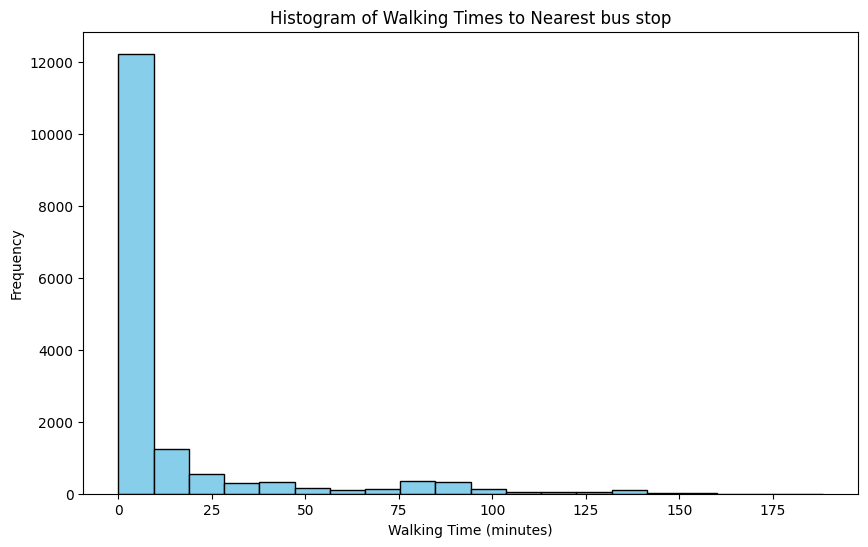

In [ ]:
# Filter out rows with no walking time (None values)
walking_times = node_to_poi_distances['walking_time_minutes'].dropna()

# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(walking_times, bins=20, color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Walking Time (minutes)')
plt.ylabel('Frequency')
plt.title('Histogram of Walking Times to Nearest bus stop')

# Show the plot
plt.show()

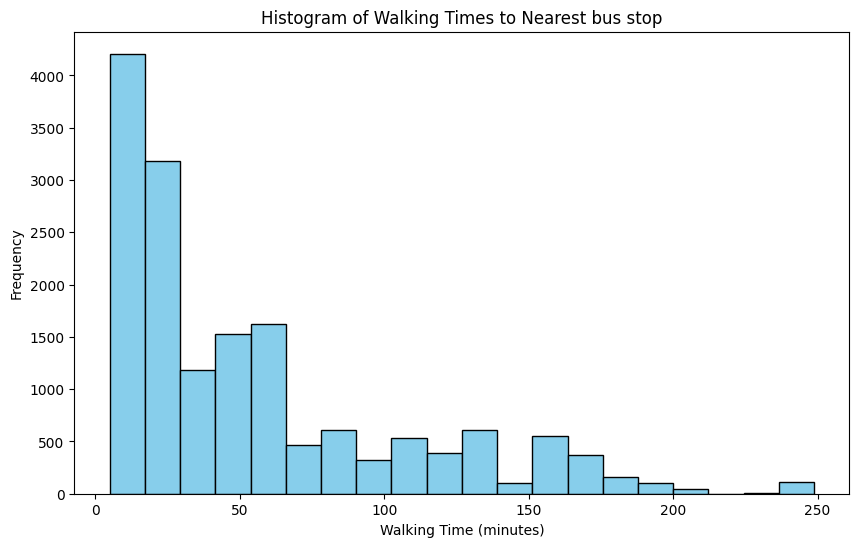

In [ ]:


# Filter out rows with no walking time (None values)
walking_times = merged_df['total_time'].dropna()

# Create the histogram
plt.figure(figsize=(10, 6))
plt.hist(walking_times, bins=20, color='skyblue', edgecolor='black')

# Add labels and title
plt.xlabel('Walking Time (minutes)')
plt.ylabel('Frequency')
plt.title('Histogram of Walking Times to Nearest bus stop')

# Show the plot
plt.show()

In [ ]:
# Define trip times and colors
trip_times = range(1, 45, 1)  # Walking times from 1 to 50 minutes
iso_colors = ox.plot.get_colors(n=len(trip_times), cmap="plasma", start=0.3)
iso_colors.reverse()

# Define a color mapping function
def color_mapping_function(val, iso_colors, trip_times):
    for time, color in zip(trip_times, iso_colors):
        if val < time:
            return color
    return iso_colors[-1]  # Default to the last color if val exceeds the maximum trip time

# Prepare node data with coordinates and colors
coords = {}
for node_id, node_data in G.nodes(data=True):
    # Get the walking time for the node (if available)
    walking_time = node_to_poi_distances.loc[node_to_poi_distances['node_id'] == node_id, 'walking_time_minutes'].values
    if len(walking_time) > 0:
        walking_time = walking_time[0]
    else:
        walking_time = None  # Handle nodes without walking time data

    # Map walking time to color
    color = color_mapping_function(walking_time, iso_colors, trip_times) if walking_time is not None else "#808080"  # Gray for nodes without data

    # Store coordinates and color
    coords[node_id] = {
        "x": node_data["x"],
        "y": node_data["y"],
        "color": color,
    }

# Create a folium map centered on the graph
m = folium.Map(location=[poi_df['Latitude'].mean(), poi_df['Longitude'].mean()], zoom_start=14)

# Plot nodes on the map
for val in coords.values():
    folium.Circle(
        location=[val["y"], val["x"]],
        radius=30,
        stroke=False,
        fill=True,
        color=val["color"],
        fill_opacity=0.5,
        interactive=True,
    ).add_to(m)

# Add a color legend
colormap = cm.LinearColormap(
    colors=iso_colors,
    index=trip_times,
    vmin=min(trip_times),
    vmax=max(trip_times),
    caption="Walking Time (minutes)",
)
colormap.add_to(m)

# Save and display the map
m.save("walking_time_map.html")
m

In [ ]:
# Define trip times and colors for total_time
trip_times = range(1, 200, 1)  # Range of total_time values (adjust as needed)
iso_colors = ox.plot.get_colors(n=len(trip_times), cmap="plasma", start=0.3)
iso_colors.reverse()

# Define a color mapping function for total_time
def color_mapping_function(val, iso_colors, trip_times):
    for time, color in zip(trip_times, iso_colors):
        if val < time:
            return color
    return iso_colors[-1]  # Default to the last color if val exceeds the maximum trip time

# Prepare node data with coordinates and colors based on total_time
coords = {}
for node_id, node_data in G.nodes(data=True):
    # Get the total_time for the node (if available)
    total_time = merged_df.loc[merged_df['node_id'] == node_id, 'total_time'].values
    if len(total_time) > 0:
        total_time = total_time[0]
    else:
        total_time = None  # Handle nodes without total_time data

    # Map total_time to color
    color = color_mapping_function(total_time, iso_colors, trip_times) if total_time is not None else "#808080"  # Gray for nodes without data

    # Store coordinates and color
    coords[node_id] = {
        "x": node_data["x"],
        "y": node_data["y"],
        "color": color,
    }

# Create a folium map centered on the graph
m = folium.Map(location=[poi_df['Latitude'].mean(), poi_df['Longitude'].mean()], zoom_start=14)

# Plot nodes on the map
for val in coords.values():
    folium.Circle(
        location=[val["y"], val["x"]],
        radius=70,  # Adjust radius as needed
        stroke=False,
        fill=True,
        color=val["color"],
        fill_opacity=0.3,
        interactive=True,
    ).add_to(m)

# Add a color legend for total_time
colormap = cm.LinearColormap(
    colors=iso_colors,
    index=trip_times,
    vmin=min(trip_times),
    vmax=max(trip_times),
    caption="Total Time (minutes)",
)
colormap.add_to(m)

# Save and display the map
m.save("total_time_map.html")
m